# **House Prices Prediction, King County, USA**

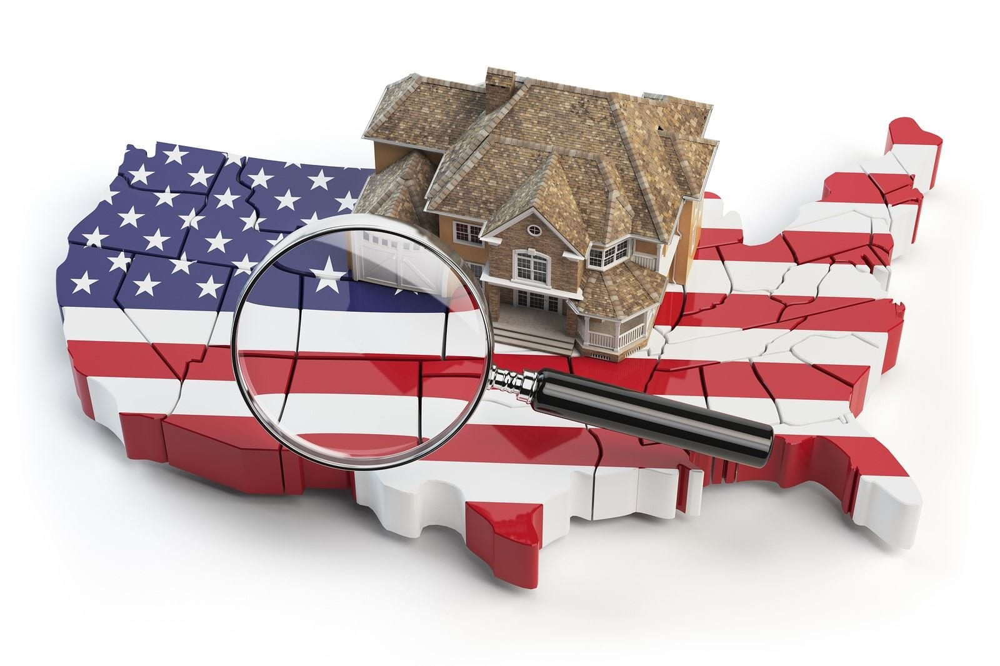

# **By Tal Gottfeld and Daniel Rodin**

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import pandas as pd
%pip install geopandas

import warnings
from sys import modules
import seaborn as sns
import folium
from folium import Choropleth, Circle, Marker
from folium.plugins import HeatMap, MarkerCluster
import branca.colormap as cm

from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split as split
from sklearn.model_selection import cross_val_score
from sklearn import preprocessing
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import MaxAbsScaler
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import pairwise_distances

# For the dimensionality reduction
from sklearn.feature_selection import SelectKBest, f_classif

# For cross validation
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import StratifiedShuffleSplit

# For Grid Search
from sklearn.model_selection import GridSearchCV, cross_val_predict

# Visualization
import pydot
from IPython.display import Image
from sklearn.externals.six import StringIO
from sklearn.tree import DecisionTreeRegressor, export_graphviz
from sklearn.tree import DecisionTreeClassifier

from scipy.optimize import curve_fit
from sklearn.metrics import pairwise_distances

from sklearn.metrics import mean_squared_log_error as msle
from sklearn.metrics import mean_squared_error as mse


# Validation
from sklearn.model_selection import train_test_split as split

warnings.filterwarnings('ignore')
%matplotlib inline


from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.datasets import load_digits
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split, cross_val_score,\
    GridSearchCV
import matplotlib.pyplot as plt

%matplotlib inline

     |████████████████████████████████| 1.0 MB 5.2 MB/s 
     |████████████████████████████████| 15.4 MB 35 kB/s 
     |████████████████████████████████| 6.3 MB 38.6 MB/s 


/usr/local/lib/python3.7/dist-packages/sklearn/externals/six.py:31: FutureWarning: The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).
  "(https://pypi.org/project/six/).", FutureWarning)


In [ ]:
import sys
if 'google.colab' in sys.modules:
    from google.colab import files
    uploaded = files.upload()

Saving kc_house_data.csv to kc_house_data.csv


In [ ]:
kc = pd.read_csv('kc_house_data.csv')
kc.shape

(21613, 21)

# Introduction


Our work has been prepared based on Regression module in the Data Science Boot Camp course. 

Our work is based on one datasets from the website 'Kaggle' kc_house_data presenting houese prices in King County,USA from May 2014 to May 2015. 

# Goals and Objectives


This project is designed to enable an initial trial with building a robust and flexible regression pipeline

Legend:

The below are descriptions of all the columns of our dataset


**id** - Unique ID for each home sold

**date** - Date of the home sale

**price** - Price of each home sold

**bedrooms** - Number of bedrooms

**bathrooms** - Number of bathrooms, where .5 accounts for a room with a toilet but no shower

**sqft_living** - Square footage of the apartments interior living space

**sqft_lot **- Square footage of the land space

**floors** - Number of floors

waterfront - A dummy variable for whether the apartment was overlooking the waterfront or not

**view** - An index from 0 to 4 of how good the view of the property was

**condition**  - An index from 1 to 5 on the condition of the apartment

**grade** - An index from 1 to 13, where 1-3 falls short of building 
construction and design, 7 has an average level of construction and design, and 11-13 have a high quality level of construction and design.

**sqft_above** - The square footage of the interior housing space that is above ground level

**sqft_basement** - The square footage of the interior housing space that is below ground level

**yr_built** - The year the house was initially built

**yr_renovated** - The year of the house’s last renovation

**zipcode** - What zipcode area the house is in

**lat** - Lattitude

**long** - Longitude

**sqft_living15** - The square footage of interior housing living space for the nearest 15 neighbors

**sqft_lot15** - The square footage of the land lots of the nearest 15 neighbors















# **1. EDA**

In [ ]:
kc.columns

Index(['id', 'date', 'price', 'bedrooms', 'bathrooms', 'sqft_living',
       'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade',
       'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode',
       'lat', 'long', 'sqft_living15', 'sqft_lot15', 'year_sold',
       'yr_since_renovation', 'house_age'],
      dtype='object')

In [ ]:
kc.head(5)

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


In [ ]:
kc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21613 non-null  int64  
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  int64  
 6   sqft_lot       21613 non-null  int64  
 7   floors         21613 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21613 non-null  int64  
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21613 non-null  int64  
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        21613 non-null  int64  
 17  lat            21613 non-null  float64
 18  long  

In [ ]:
kc.nunique()

id               21436
date               372
price             4028
bedrooms            13
bathrooms           30
sqft_living       1038
sqft_lot          9782
floors               6
waterfront           2
view                 5
condition            5
grade               12
sqft_above         946
sqft_basement      306
yr_built           116
yr_renovated        70
zipcode             70
lat               5034
long               752
sqft_living15      777
sqft_lot15        8689
dtype: int64

In [ ]:
print(kc.isnull().sum())

id                         0
date                       0
price                      0
bedrooms                   0
bathrooms                  0
sqft_living                0
sqft_lot                   0
floors                     0
waterfront                 0
view                       0
condition                  0
grade                      0
sqft_above                 0
sqft_basement              0
yr_built                   0
yr_renovated           20699
zipcode                    0
lat                        0
long                       0
sqft_living15              0
sqft_lot15                 0
year_sold                  0
yr_since_renovation    20699
house_age                  0
dtype: int64


In [ ]:
#We checked the below colums, and only 2 were found containing substantial zero values:
# (kc['zipcode'] == 0).sum()
# (kc['grade'] == 0).sum()
# (kc['waterfront'] == 0).sum()
# (kc['bedrooms'] == 0).sum()
# (kc['bathrooms'] == 0).sum()
# (kc['floors'] == 0).sum()
# (kc['view'] == 0).sum()
# (kc['condition'] == 0).sum()
# (kc['sqft_living'] == 0).sum()

In [ ]:
(kc['view'] == 0).sum()

19467

In [ ]:
kc.bedrooms.value_counts().sort_index() #outliers?
kc.bathrooms.value_counts().sort_index()


0       13
1      199
2     2760
3     9824
4     6882
5     1601
6      272
7       38
8       13
9        6
10       3
11       1
33       1
Name: bedrooms, dtype: int64

In [ ]:
kc.bathrooms.value_counts().sort_index()

0.00      10
0.50       4
0.75      72
1.00    3852
1.25       9
1.50    1446
1.75    3048
2.00    1930
2.25    2047
2.50    5380
2.75    1185
3.00     753
3.25     589
3.50     731
3.75     155
4.00     136
4.25      79
4.50     100
4.75      23
5.00      21
5.25      13
5.50      10
5.75       4
6.00       6
6.25       2
6.50       2
6.75       2
7.50       1
7.75       1
8.00       2
Name: bathrooms, dtype: int64

In [ ]:
(kc['waterfront'] == 0).sum()

21427

## 1.1 Understanding our data







We will explore our data by features and overall correlations and trends

Price

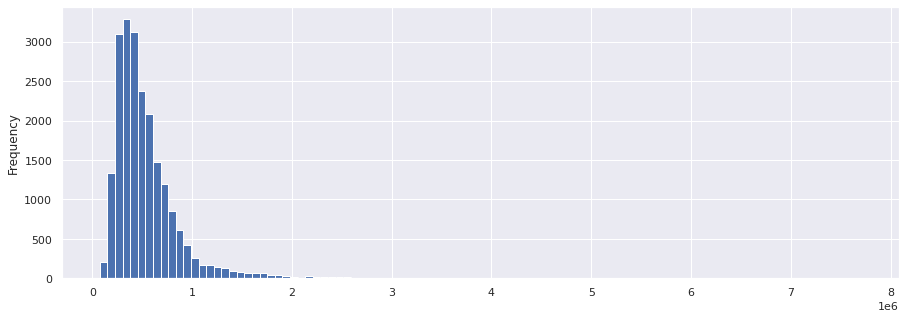

In [ ]:
#Let's begin with out objective variable - price, and see how it behaves.  

kc.price.plot.hist(figsize=(15,5), bins=100)

In [ ]:
kc.price.max()

7700000.0

In [ ]:
kc.price.min()

75000.0

In [ ]:
kc.loc[kc['price'] == 7700000]

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,years,yr_since_renovation
7252,6762700020,20141013T000000,7700000.0,6,8.0,12050,27600,2.5,0,3,4,13,8570,3480,1910,1987.0,98102,47.6298,-122.323,3940,8800,2014,27.0


In [ ]:
kc.price.median()

450000.0

In [ ]:
#Understanding our price groups and price data
kc.groupby('price').size().nlargest(30).sort_index(ascending=False) #.plot.hist();

price
650000.0    117
600000.0    110
550000.0    159
525000.0    131
500000.0    152
475000.0    120
450000.0    172
440000.0    109
435000.0    105
425000.0    150
420000.0     97
415000.0    111
400000.0    145
390000.0    110
375000.0    138
360000.0     96
350000.0    172
340000.0    103
335000.0     98
330000.0    119
325000.0    148
320000.0    108
315000.0    111
310000.0    101
300000.0    133
280000.0    110
275000.0    113
265000.0     95
260000.0     95
250000.0    130
dtype: int64

In [ ]:
kc.loc[kc['price'] == 600000]

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,labels,year_sold,yr_since_renovation,house_age
52,7518505990,20141231T000000,600000.0,3,1.75,1410,4080,1.0,0,0,4,7,1000,410,1950,NaN,98117,47.6808,-122.384,1410,4080,52,2014,NaN,64
1255,1624079051,20140710T000000,600000.0,2,2.50,2410,102366,1.0,0,0,4,7,1940,470,1912,1989.0,98024,47.5629,-121.918,2460,310582,52,2014,25.0,102
1319,1962200036,20140819T000000,600000.0,3,1.75,1620,1325,2.5,0,0,3,9,1430,190,2005,NaN,98102,47.6498,-122.321,1750,1572,52,2014,NaN,9
1701,8080400045,20140620T000000,600000.0,2,1.00,1040,3600,1.0,0,0,4,7,1040,0,1919,1980.0,98112,47.6190,-122.311,2250,4800,52,2014,34.0,95
1739,626100023,20140611T000000,600000.0,5,2.75,2910,53898,1.0,0,0,5,7,1510,1400,1979,NaN,98077,47.7201,-122.062,3210,216928,52,2014,NaN,35
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19970,8562770110,20141027T000000,600000.0,3,3.50,2710,3290,2.0,0,0,3,8,1650,1060,2006,NaN,98027,47.5367,-122.072,2440,3290,52,2014,NaN,8
20376,3304300380,20150108T000000,600000.0,5,2.75,3380,8179,2.0,0,0,3,9,3380,0,2011,NaN,98059,47.4827,-122.135,2840,8179,52,2015,NaN,4
20712,847100046,20150416T000000,600000.0,4,2.75,3110,11225,2.0,0,0,3,8,3110,0,2012,NaN,98059,47.4865,-122.143,2610,8535,52,2015,NaN,3
20929,3528900771,20150331T000000,600000.0,3,3.25,1690,1473,2.0,0,0,3,8,1380,310,2008,NaN,98109,47.6397,-122.345,1670,2594,52,2015,NaN,7


Sqft living and lot - Over size of the house and outdoors (in accordance)

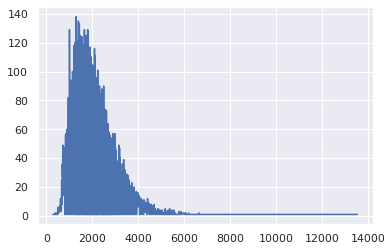

In [ ]:
#The size of house distribution in KC. Next we will clean the outliers
kc.sqft_living.value_counts().sort_index(ascending=False).plot();

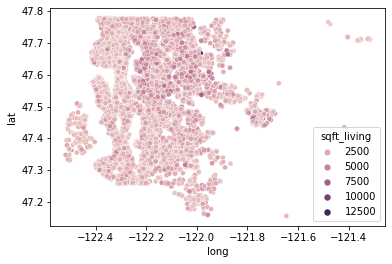

In [ ]:
# We can see above the size of the houses in KC
# Let's check where they are in KC:
# sns.relplot(x="long", y="lat", hue ="sqft_living",palette=("ch:s=.25,rot=-.25"), data=kc, sizes=(10,8));

minsize = min(kc['sqft_living'])
maxsize = max(kc['sqft_living'])
ax = sns.scatterplot(x="long", y="lat",
                    hue="sqft_living", size="sqft_living",sizes=(25,30),
                    data=kc)

# The largest houses align to the prices distribution. We have an indicator of luxury neighborhoods in central KC

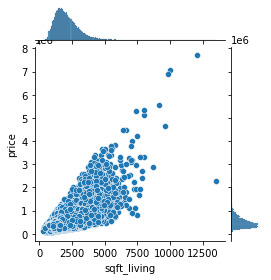

In [ ]:
sns.jointplot(kc.sqft_living, kc.price, height=4)
plt.xlabel('Sqft Living')
plt.ylabel('Sale Price')
plt.show()

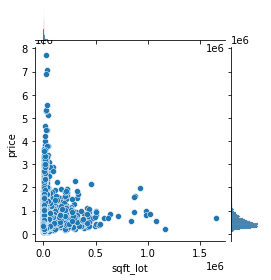

In [ ]:
# There is no correlation between price and sqft lot (even if we clean outliers). We may drop this feature
sns.jointplot(kc.sqft_lot, kc.price, height=4)
plt.xlabel('Sqft Lot')
plt.ylabel('Sale Price')
plt.show()

In [ ]:
kc.sqft_lot.shape

(21613,)

Rooms quantity - Bedrooms and bathrooms

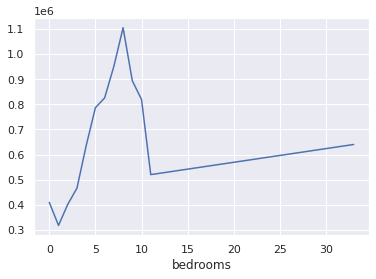

In [ ]:
# We tried to see how key features behave. We can see in the two graphs below that we have cleaning work to do, as number of transactions determine the trend
kc.groupby('bedrooms')['price'].mean().plot();

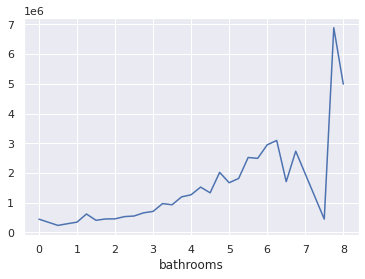

In [ ]:
kc.groupby('bathrooms')['price'].mean().plot();

# We can see the data does not behave 'correctly' (example - 7.5 bathrooms). We may suspect that our data was filled manually

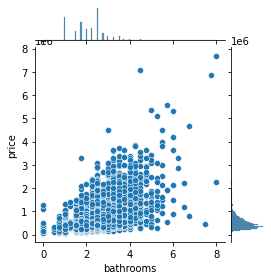

In [ ]:
sns.jointplot(kc.bathrooms, kc.price, height=4)
plt.xlabel('bathrooms')
plt.ylabel('bathorooms')
plt.show()

In [ ]:
kc.bathrooms.value_counts().sort_index()

1.00    3833
1.25       9
1.50    1445
1.75    3040
2.00    1925
2.25    2045
2.50    5369
2.75    1181
3.00     746
3.25     582
3.50     725
3.75     151
4.00     131
4.25      77
4.50      98
4.75      22
5.00      18
5.25      11
5.50       4
Name: bathrooms, dtype: int64

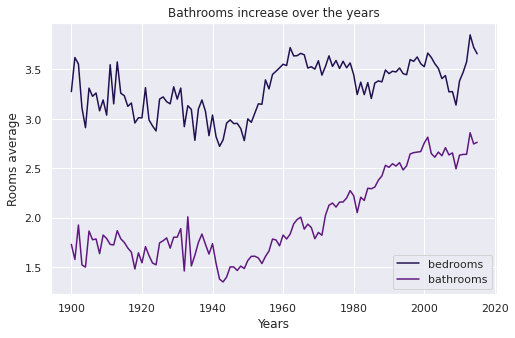

In [ ]:
# We will now review how rooms trend changed over the years

kc.groupby('yr_built')['bedrooms','bathrooms'].mean().plot(title="Bathrooms increase over the years", xlabel="Years", ylabel="Rooms average", figsize=(8,5))

# It seems that starting from the 50's, there is growing demand for more bathrooms and bedrooms which align with the growth of credit per household (the launch of the credit card)

Renovated

In [ ]:
# Lets see how many values we have, if any: 
kc.yr_renovated.loc[kc['yr_renovated'] != 0].count()

914

In [ ]:
# We would like to understand better the relationship between renovated house to non-renovated, it's condition and the year built.
# We will create a column to calculate years since renovation and compare it over the years

kc['year_sold'] = kc['date'].apply(lambda x : int(x[0:4]))
kc['yr_since_renovation'] = kc['year_sold'] - kc['yr_renovated']

kc['yr_since_renovation'] = kc['yr_since_renovation'].apply(lambda x : x if x < 100 else np.nan)
kc['yr_renovated'].replace(0, np.nan, inplace=True)

kc['yr_renovated'].replace(0, np.nan, inplace=True)

# We will see our findings in the following parametres

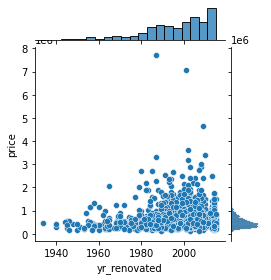

In [ ]:
sns.jointplot(kc.yr_renovated, kc.price, height=4)
plt.xlabel('Year Renovated')
plt.ylabel('Sale Price')
plt.show()

# Our results are biased as they represent only 5% of the properties (914)

Year built

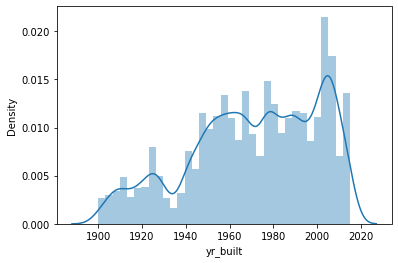

In [ ]:
sns.distplot(kc['yr_built']);

House Age

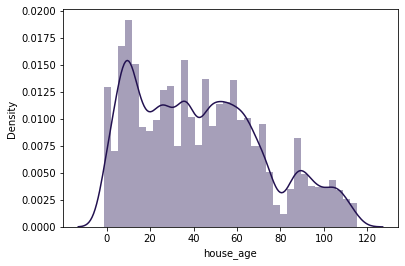

In [ ]:
# The median age of our houses is:
age = kc['house_age'] = kc['year_sold'] - kc['yr_built']

sns.set_palette("magma")
sns.distplot(kc['house_age']);

# Our graphs show most of the houses in KC are above 20+ yrs/o. Meaning we could have expected to see more renovations. Nonetheless, the renovated homes are only 5%..
# We would have expected to see the influence on the condition factor. We further discuss the condition factor in the next variables review

Basement

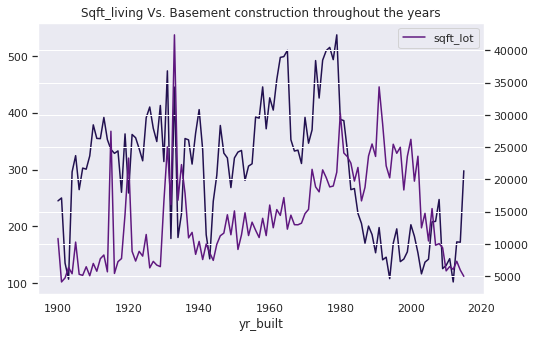

In [ ]:
ax = kc.groupby('yr_built')['sqft_basement'].mean().plot()
kc.groupby('yr_built')['sqft_lot'].mean().plot(secondary_y=True, ax=ax, figsize=(8,5), title="Sqft_living Vs. Basement construction throughout the years");
plt.legend();


# We can see basements were highly popular in the construction sector during the Vietnam and the Cold-War (60's and 80's, accordingly).
# Sqft lot, on the other hand (size of house, including backyard), got smaller over the years, indicating we are seeing an urbanization trend.

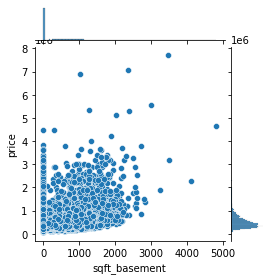

In [ ]:
sns.jointplot(kc.sqft_basement, kc.price, height=4)
plt.xlabel('Sqft_basement')
plt.ylabel('Sale Price')
plt.show()

Condition 

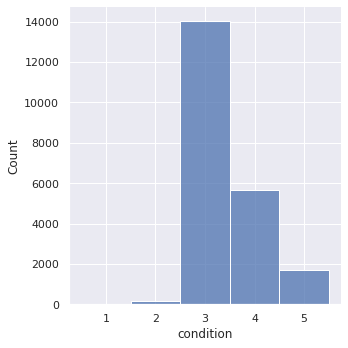

In [ ]:
sns.displot(kc, x="condition", discrete=True);

# When choosing from a scale of #5, we usually tend to pick the middle number. We can assume the numbers below are 'conveniant' numbers and do not represent 
# the real condition distribution. In addition, we saw earlier that most of the houses are 20+ and above years old. 
# Therefore, we could have expected to see a larger number  of 1-2 condition rate.
# We conclude that we can not draw a direct link between house price and condition.

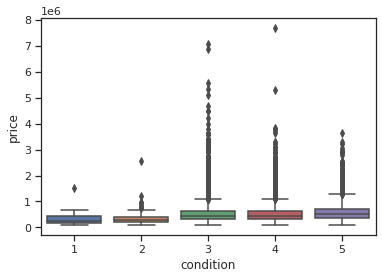

In [ ]:
# Our assumptions line up with the price correlation graph below. 
# The graph shows us that the indicator does not give us any new knowledge, e.g. condition #4 and #5 should have shown us the highest prices but do not.
sns.set_theme(style="ticks")
sns.boxplot(x="condition", y='price', 
                    data=kc);

Grade

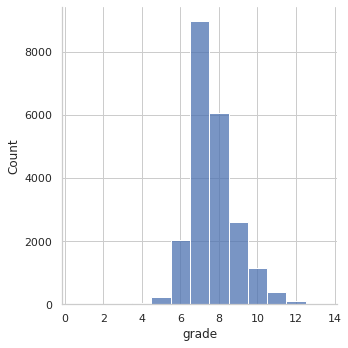

In [ ]:
# We will examine the grade distribution:
sns.displot(kc, x="grade", discrete=True);

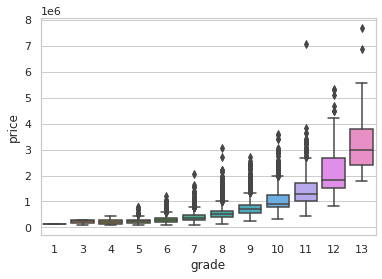

In [ ]:
# Lets test grade rank correlation to the price. It is impactful.
sns.set_theme(style="whitegrid")
sns.boxplot(x="grade", y='price', 
                    data=kc);

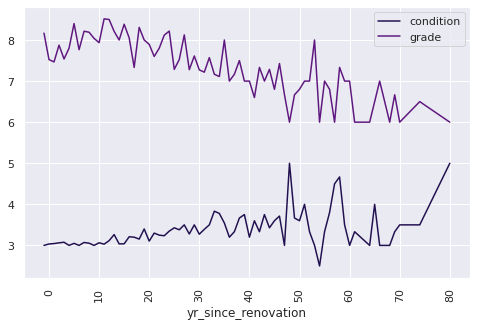

In [ ]:
# Lets create an integrated view of condition and grade and how they are affected by the price of the property

kc.groupby('yr_since_renovation')['condition', 'grade'].mean().plot(rot=90, figsize=(8,5));

# We can clearly see that condition does not contribute to our analysis. Most of the properties ranked an average of #3, while the age of most of the houses is above 20yrs and only a small precentage renovated.

Waterfront

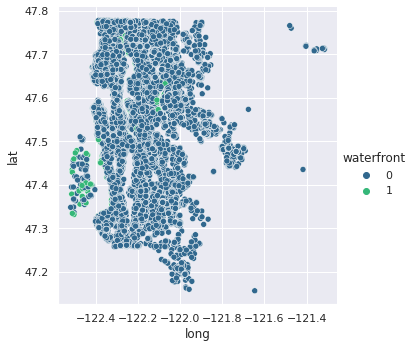

In [ ]:
sns.relplot(x="long", y="lat", hue ="waterfront",palette="viridis", data=kc);

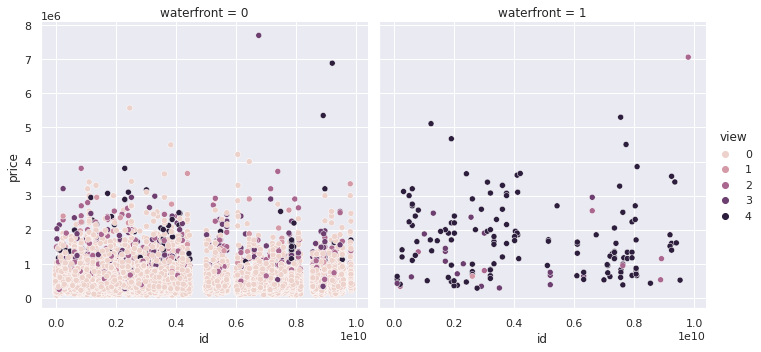

In [ ]:
# There were only a few houses in the market in 2014-2015 with waterfront and the few that does, do not show any correlation with the price

sns.relplot(x="id", y="price", hue="view",
            col="waterfront", data=kc, height=5);

View

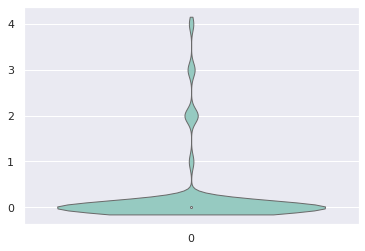

In [ ]:
sns.violinplot(data=kc.view, palette="Set3", bw=.2, cut=1, linewidth=1);
# We can can see the view column does not contribute much to our analysis. In addition, we saw that said column contains a lot of zeros

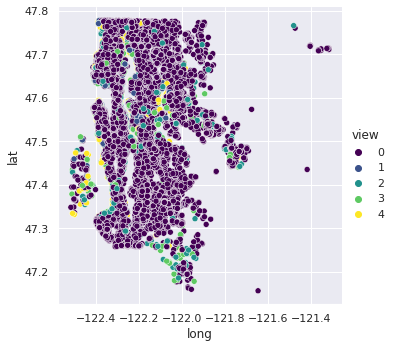

In [ ]:
sns.relplot(x="long", y="lat", hue ="view",palette="viridis", data=kc);

# The view distribution does not align with the geographic placement, especially on the mid-west, near the waters.

Zipcode

In [ ]:
kcc = kc.groupby('price')['zipcode'].value_counts().sort_values().nlargest(10)

# We can see that the most expensive houses come from 98103, which is a "Seattle" zipcode. 
# The second place belongs to "Redmond", which is commonly recognized as the home of Microsoft and Nintendo of America.
kcc.sort_index(level=0, ascending=False)

price     zipcode
650000.0  98103      10
550000.0  98006      10
500000.0  98133      10
475000.0  98034      11
390000.0  98058      10
375000.0  98133      11
350000.0  98118      11
325000.0  98106      10
320000.0  98059      10
270000.0  98042      12
Name: zipcode, dtype: int64

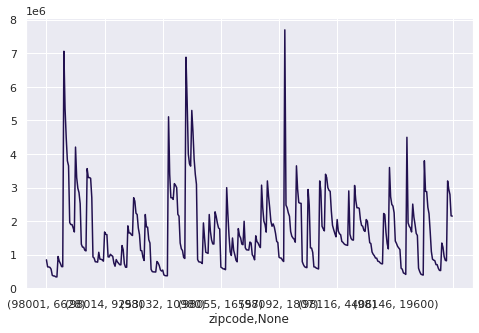

In [ ]:
# We now try to view price distribution according to zipcode, e.g. neighborhood classification
kc.groupby('zipcode')['price'].nlargest().plot(figsize=(8,5));

Cordinators - Lat and long

In [ ]:
kc = kc.loc[kc['long'] <-121.6,:]
kc.shape

(21596, 21)

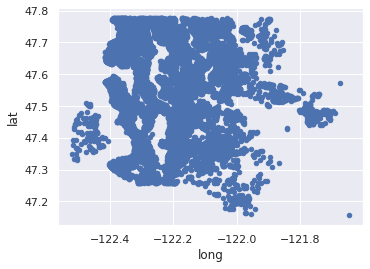

In [ ]:
# Lets view our properties distribution. Does it truly represent a reliable view of King County prices?
# Yes, we actually see that they represent every point on the KC map.

# Below we just tidy up a bit of outliers 
kc = kc.loc[kc['long'] <-121.6,:]
kc.shape

ax = kc.plot.scatter(x='long',y='lat', color='b')
ax.set_aspect(1)

In [ ]:
(kc.groupby(['zipcode'])['price'].median())

zipcode
98001     260000.0
98002     235000.0
98003     267475.0
98004    1150000.0
98005     765475.0
           ...    
98177     554000.0
98178     278277.0
98188     264000.0
98198     265000.0
98199     689800.0
Name: price, Length: 70, dtype: float64

In [ ]:
kc_map = folium.Map(location= [47.56 , -122.22], zoom_start =14) 

kc_map = folium.Map(location= [47.56 , -122.22], zoom_start =8)

def color_map(val):
    if val <= 150000:
      return 'yellow'
    elif val <= 200000:
      return 'gold'
    elif val <= 300000:
      return 'orange'
    elif val <= 450000:
      return 'nightcoral'
    elif val <= 1500000:
      return 'maroon'
    else:
        return 'pink'

# bubble map 
for i in range(0,len(kc)):
    Circle(
        location=[kc.iloc[i]['lat'], kc.iloc[i]['long']],
        radius=20,
        color=color_map(kc.iloc[i]['price'])).add_to(kc_map)

kc_map

Let's wrap up our work so far, and see how we proceed with the analysis and cleaning for the models deplyoment

1.13 Conclusion: We reviewed and analyzed the dataset. 
We found some of our columns could not serve us in the analysis. Either, from lack of data (zero values) or data integrity (view, waterfront, renovation) or data reliability (condition parameter, bed and bathrooms which seems to be filled manually)

Below, you may see our mid-EDA conclusion in graph:

NameError: ignored

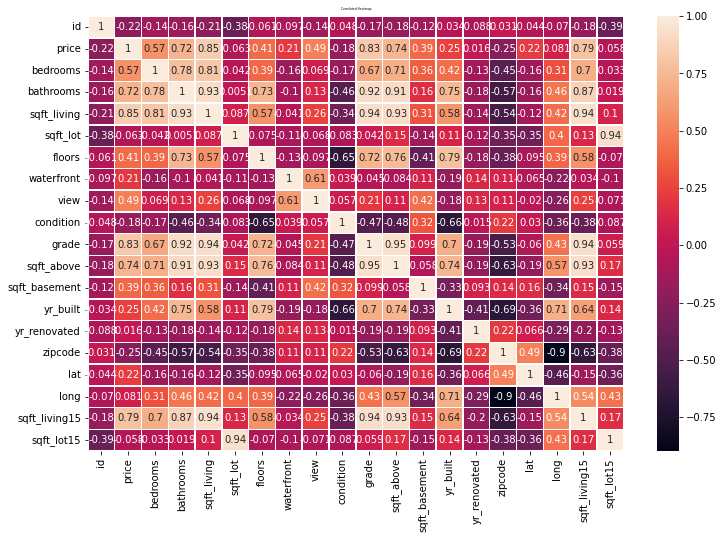

In [ ]:
# Final view before cut off:

corrMatrix = kc.corr()
f, ab = plt.subplots(figsize=(12,8))
plt.title('Correlated Heatmap',fontsize=3)
sns.heatmap(corrMatrix.corr(),linewidths=.5,annot=True)
fig.tight_layout()
plt.show()

Reviewing our key features and their correlation to price

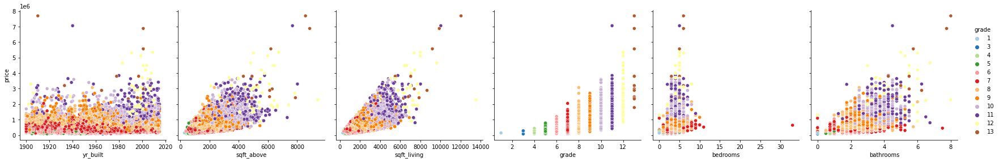

In [ ]:
sns.pairplot(data=kc,
                  x_vars=['yr_built','sqft_above', 'sqft_living','grade','bedrooms','bathrooms'],
                  y_vars=['price'], palette="Paired",size=4, hue="grade");

# **2. Deployment of Regression Models**

## 2.1 Linear Regression

### 2.1.1 Pre-processing / Standartising the data

#### Feature Selection

We will start with cleaning our data according to our findings so far:

Removing irrelevant columns

In [ ]:
# After initial analysis we chose columns we can remove as they do not contribute to our goal. 

# The date of transaction does not serve us. Our dataset is 2014-2015, a specific date will not add to our model
kc.drop('date',axis=1,inplace=True)

# Rest to our index
# The id column will not assist our analysis. We can drop it.
kc.drop('id',axis=1, inplace=True)

# The variable represents sqft_basement. It does not contribute to our anlysis and is embedded in sqft_living and has a low correlation to our target
kc.drop('sqft_basement',axis=1,inplace=True)

# As discussed earlier, the lot feature does not correlate with our price target.
kc.drop('sqft_lot',axis=1,inplace=True)

# Column 'floor' - As we have sqft_living which gives us the overall size of the house. It is sufficient at this stage
kc.drop('floors', axis=1, inplace=True)

# The prox of socio-economic scale of the neighborhood will not be of use at this stage nor other geo factors
kc.drop(['lat','long','sqft_living15','sqft_lot15'], axis=1, inplace=True)

# We found in the above analysis columns, which do not contribute any new or valid info for us including columns we creased for the EDA analysis
kc.drop(['view','waterfront','condition','year_sold','yr_since_renovation','house_age','yr_renovated'], axis=1, inplace=True)



In [ ]:
kc.drop(['yr_built'], axis=1, inplace=True)

The before cleaning

In [ ]:
kc.bedrooms.shape

(21613,)

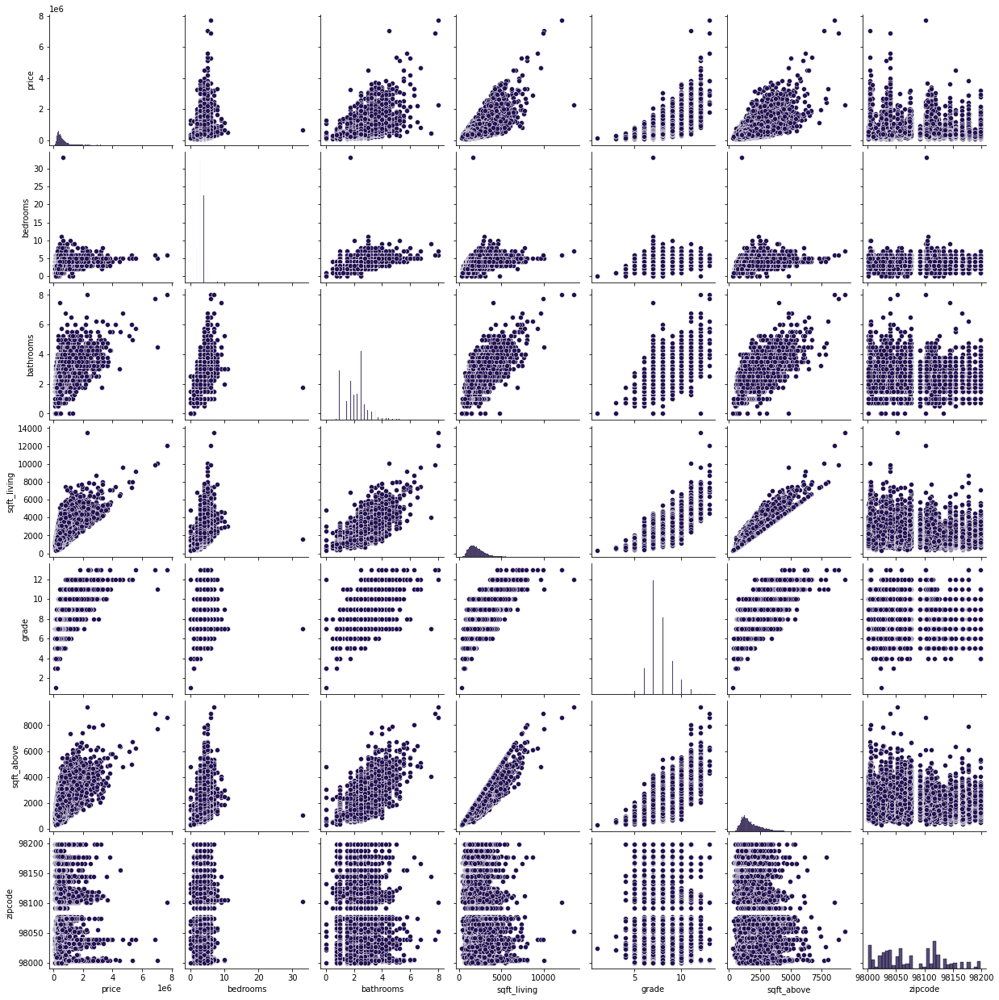

In [ ]:
sns.pairplot(kc);

Cleaning outliers and key parameters (trial and error to fine tune the right threshold)

In [ ]:
# Price

kc = kc.loc[kc['price'] <= 4000000]

In [ ]:
# Rooms

kc = kc.loc[kc['bedrooms'] >= 1]
kc = kc.loc[kc['bedrooms'] <= 9]
kc = kc.loc[kc['bathrooms'] >= 1]
kc = kc.loc[kc['bathrooms'] <= 5.5]

In [ ]:
# Sqft living and lot

kc = kc.loc[kc['sqft_living'] <= 7000]

In [ ]:
# Sqft_above

kc = kc.loc[kc['sqft_above'] <= 6000]

In [ ]:
# Grade scale

kc = kc.loc[kc['grade'] >= 4.5]

Reengineering the 'zipcode' column 

In [ ]:

# Only now we can redesign the column (otherwise, our results will be distorted)
ax =  kc.groupby('zipcode')['price'].mean()
ax =ax.reset_index()

In [ ]:
kc = pd.merge(kc, ax, how='left', on="zipcode")

# QA of the zip_value column
kc.loc[kc['zipcode'] == 98028]['price_x'].mean()

kc.head(3)

,price_x,bedrooms,bathrooms,sqft_living,grade,sqft_above,yr_built,zipcode,price_y
0,221900.0,3,1.00,1180,7,1180,1955,98178,311225.161538
1,538000.0,3,2.25,2570,7,2170,1951,98125,470190.848039
2,180000.0,2,1.00,770,6,770,1933,98028,463304.432624


In [ ]:
kc.rename(columns={'price_y': "zip_value", "price_x": "price"}, inplace=True)

In [ ]:

# Now we can remove the 'zipcode' column
kc.drop(['zipcode'], axis=1, inplace=True)

Post cleaning

In [ ]:
kc.head()

,price,bedrooms,bathrooms,sqft_living,grade,sqft_above,yr_built,zip_value
0,221900.0,3,1.00,1180,7,1180,1955,311225.161538
1,538000.0,3,2.25,2570,7,2170,1951,470190.848039
2,180000.0,2,1.00,770,6,770,1933,463304.432624
3,604000.0,4,3.00,1960,7,1050,1965,552920.118321
4,510000.0,3,2.00,1680,8,1680,1987,686357.152273


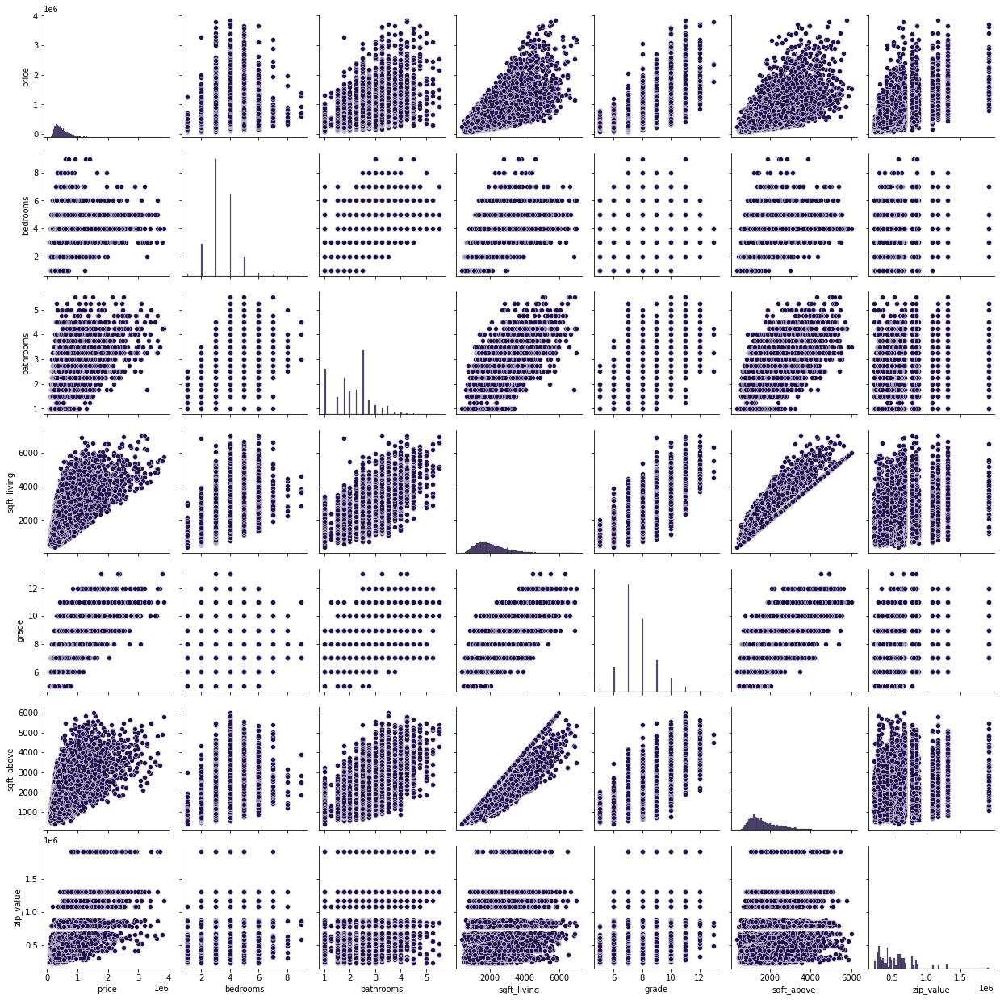

In [ ]:
sns.pairplot(kc);

Our EDA helped us to determine key parameters as we see in the correlated chart above. A total of 8 features:

In [ ]:
kc.columns

Index(['price', 'bedrooms', 'bathrooms', 'sqft_living', 'grade', 'sqft_above',
       'zip_value'],
      dtype='object')

In [ ]:
kc.head()

NameError: ignored

Split

In [ ]:
kc_train, kc_test = split(kc, test_size=0.3, 
                              random_state=11320)

In [ ]:
X_train = kc_train.drop('price', axis=1)
y_train = kc_train['price']

Scaling

In [ ]:
my_scaler = MaxAbsScaler().fit(X_train)
X_train_scaled = pd.DataFrame(my_scaler.transform(X_train), columns=X_train.columns)
X_train_scaled.head()

,bedrooms,bathrooms,sqft_living,grade,sqft_above,zip_value
0,0.444444,0.454545,0.405483,0.692308,0.469115,0.175352
1,0.444444,0.454545,0.389610,0.692308,0.450751,0.324636
2,0.333333,0.545455,0.340548,0.538462,0.297162,0.245948
3,0.444444,0.454545,0.476190,0.692308,0.287145,0.345532
4,0.333333,0.272727,0.369408,0.615385,0.277129,0.569492


In [ ]:
# Scaling our Y
y_train = np.log(y_train)

Fitting our model

In [ ]:
kc_lm = LinearRegression().fit(X_train_scaled, y_train)

In [ ]:
list(zip(X_train.columns, kc_lm.coef_))

[('bedrooms', -0.20255990855191444),
 ('bathrooms', 0.06114670283495216),
 ('sqft_living', 1.820593023712346),
 ('grade', 1.386478794748041),
 ('sqft_above', -0.32266511484525484),
 ('zip_value', 2.2509343929839436)]

In [ ]:
print("The model intercept is: {}".format(kc_lm.intercept_))

The model intercept is: 11.202216615193885


In [ ]:
y_train_pred = kc_lm.predict(X_train_scaled)


In [ ]:
rmsle = np.sqrt(mse(y_train,
                                  y_train_pred))
print("RMSLE = {:.2f}".format(rmsle))

RMSLE = 0.25


In [ ]:
RMSE = mse(np.exp(y_train), np.exp(y_train_pred))**0.5
RMSE

188498.5519470964

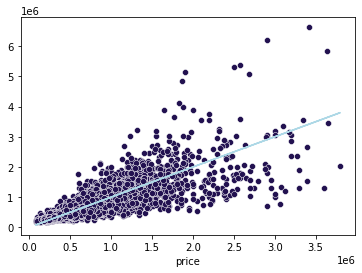

In [ ]:
ax = sns.scatterplot(x=np.exp(y_train), y=np.exp(y_train_pred))
ax.plot(np.exp(y_train), np.exp(y_train), 'lightblue');

In [ ]:
X_test = kc_test.drop('price', axis=1)
y_test = kc_test['price']

In [ ]:
X_test_scaled = pd.DataFrame(my_scaler.transform(X_test), columns=X_test.columns)

In [ ]:
y_test = np.log(y_test)

In [ ]:
y_test_pred = kc_lm.predict(X_test_scaled)

In [ ]:
rmsle = np.sqrt(mse(y_test,
                                  y_test_pred))
print("RMSLE = {:.2f}".format(rmsle))

RMSLE = 0.25


In [ ]:
RMSE = mse(np.exp(y_test), np.exp(y_test_pred))**0.5
RMSE

218563.07441404098

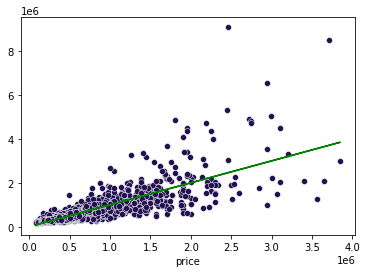

In [ ]:
#the test results are exactly the same. We can understand we need to further review our model
ax = sns.scatterplot(x=np.exp(y_test), y=np.exp(y_test_pred))
ax.plot(np.exp(y_test), np.exp(y_test), 'g');

We have a RMSE of 15.9%

### 2.1.2 Tweaking the model - Performance Improvement

Tweak 1 - Review our model before fine tuning 

In [ ]:
# RMSE = mse(np.exp(y_train), np.exp(y_train_pred))**0.5
# RMSE

188470.73291064918

In [ ]:
# RMSE = mse(np.exp(y_test), np.exp(y_test_pred))**0.5
# RMSE

218337.94537861584

Our result require fine tuning to the model and the hyperparameters 

Tweak 1 - Remove 'Sqft_lot'

In [ ]:
#The train set
# RMSE = mse(np.exp(y_train), np.exp(y_train_pred))**0.5
# RMSE

188498.5519470964

In [ ]:
#The test results
# RMSE = mse(np.exp(y_test), np.exp(y_test_pred))**0.5
# RMSE

218563.07441404098

In [ ]:
#We still have an exception of 13%. We'll continue to optimize the model
# ax = sns.scatterplot(x=y_test, y=y_test_pred)
# ax.plot(y_test, y_test, 'g');

*Tweak* 2 - Remove Yr_built

In [ ]:
#The train data
# RMSE = mse(np.exp(y_train), np.exp(y_train_pred))**0.5
# RMSE

200880.8739449632

In [ ]:
#The test results
# RMSE = mse(np.exp(y_test), np.exp(y_test_pred))**0.5
# RMSE

#The results are worsen by 2%. We will continue our analysis

235758.25352278337

Tweak 3 - Remove Sqft_above and bedrooms

In [ ]:
#The train set
# RMSE = mse(np.exp(y_train), np.exp(y_train_pred))**0.5
# RMSE

203763.59865330884

In [ ]:
# The test data
# RMSE = mse(np.exp(y_test), np.exp(y_test_pred))**0.5
# RMSE

#Our reslts have improved from tweak 2 but still larger than pre-tweak cleaning.

235758.25352278337

### 2.1.3 Conclusion

The optimal result we recieved is 13%. We can see that although profound analysis of every parameter, the model is not sufficient for precise results 

## 2.2 Decision Tree

In [ ]:
# kc.drop(['sqft_above','bedrooms'], axis=1, inplace=True)

In [ ]:
X = kc.drop('price', axis=1)
y = kc.price

#### 2.2.1 Split

In [ ]:
X_train, X_test, y_train, y_test = split(X, y, random_state=9123,test_size=0.3)

### 2.2.2. Fitting 

In [ ]:
y_train = np.log(y_train)

In [ ]:
dt_model = DecisionTreeRegressor(max_depth= 40,min_samples_split=20,min_samples_leaf=20).fit(X_train, y_train)
dt_model

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=40,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=20, min_samples_split=20,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

In [ ]:
def visualize_tree(model, md=2):
    dot_data = StringIO()  
    export_graphviz(model, out_file=dot_data, feature_names=X_train.columns, max_depth=md)
    graph = pydot.graph_from_dot_data(dot_data.getvalue())[0]  
    return Image(graph.create_png(), width=800) 

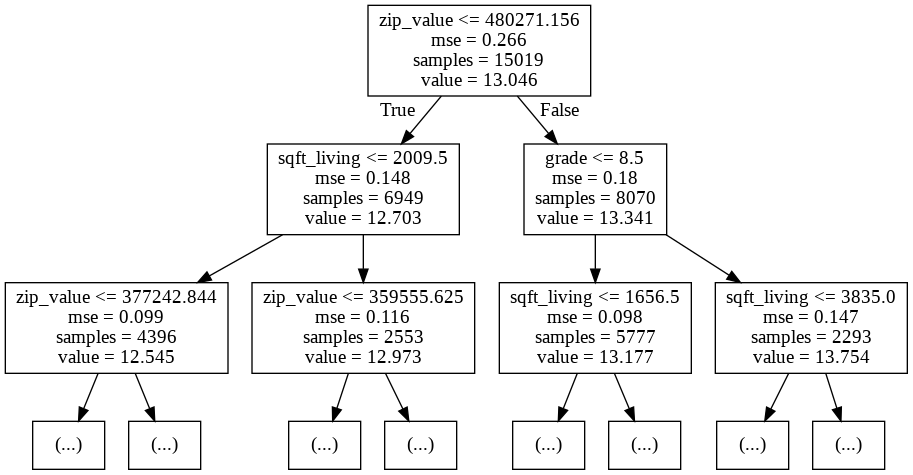

In [ ]:
visualize_tree(dt_model, md=2)

In [ ]:
for feature, importance in zip(X.columns, dt_model.feature_importances_):
    print(f'{feature:12}: {importance}')

bedrooms    : 0.0012394053628993391
bathrooms   : 0.003221291063051018
sqft_living : 0.22069044708798036
grade       : 0.18529542315575007
sqft_above  : 0.011137228102840194
zip_value   : 0.578416205227479


In [ ]:
y_train_pred = dt_model.predict(X_train)

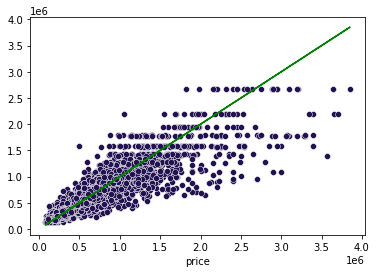

In [ ]:
ax = sns.scatterplot(x=np.exp(y_train), y=np.exp(y_train_pred))
ax.plot(np.exp(y_train), np.exp(y_train), 'g');

In [ ]:
rmsle = np.sqrt(mse(y_train,
                                  y_train_pred))
print("RMSLE = {:.2f}".format(rmsle))

RMSLE = 0.20


In [ ]:
RMSE = mse(np.exp(y_train), np.exp(y_train_pred))**0.5
RMSE

146041.45519896617

### 2.2.3 Validating the model

In [ ]:
y_test_pred = dt_model.predict(X_test)

In [ ]:

y_test = np.log(y_test)

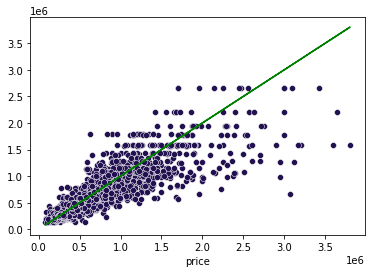

In [ ]:
ax = sns.scatterplot(x=np.exp(y_test), y=np.exp(y_test_pred))
ax.plot(np.exp(y_test), np.exp(y_test), 'g');

In [ ]:
rmsle = np.sqrt(mse(y_test,
                                  y_test_pred))
print("RMSLE = {:.2f}".format(rmsle))

RMSLE = 0.22


In [ ]:
RMSE = mse(np.exp(y_test), np.exp(y_test_pred))**0.5
RMSE

173914.5475631894

The above is our best results to date, with a 16% rmse. The model is valid but far of from optimal result

### 2.2.4 Tweaking our model 

Tweak 1 -Hyper-parameters - max_depth from 20 to 30 & min_samples_leaf from 1 to 500)

In [ ]:
# We tried the following change to our hyper-parameters - max_depth from 20 to 30 & min_samples_leaf from 1 to 500)
dt_model = DecisionTreeRegressor(max_depth=30,min_samples_leaf=500).fit(X_train, y_train)
dt_model

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=30,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=500, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

In [ ]:
#The train set
RMSE = mse(np.exp(y_train), np.exp(y_train_pred))**0.5
RMSE

197120.1667891828

In [ ]:
#The test set
RMSE = mse(np.exp(y_test), np.exp(y_test_pred))**0.5
RMSE

213828.93387400196

We a gap of 7.5% between the train and test. Our tweak is valid. The rmse is still high, so we'll try another one..

Tweak 2 - leaf_depth - 40, max_leaf_nodes - 80

In [ ]:
#The train set
RMSE = mse(np.exp(y_train), np.exp(y_train_pred))**0.5
RMSE

154758.6769385523

In [ ]:
#The test set
RMSE = mse(np.exp(y_test), np.exp(y_test_pred))**0.5
RMSE

176728.81181024667

Great results but apperantly this is overfitting. Lets see our coef

In [ ]:
for feature, importance in zip(X.columns, dt_model.feature_importances_):
    print(f'{feature:12}: {importance}')

bedrooms    : 0.0
bathrooms   : 0.0
sqft_living : 0.21781901551583963
grade       : 0.18995638437414475
sqft_above  : 0.0010732028203181995
yr_built    : 0.01363062231034886
zip_value   : 0.5775207749793485


Tweak 3 - Transform Criterion from mse to mae with depth of 40

In [ ]:
#The train set
RMSE = mse(np.exp(y_train), np.exp(y_train_pred))**0.5
RMSE

10272.137786437403

In [ ]:
#The test set
RMSE = mse(np.exp(y_test), np.exp(y_test_pred))**0.5
RMSE

218935.11520961672

In [ ]:
for feature, importance in zip(X.columns, dt_model.feature_importances_):
    print(f'{feature:12}: {importance}')

bedrooms    : 0.024803116295726645
bathrooms   : 0.038237291830004384
sqft_living : 0.28947947776908006
grade       : 0.06404080100196206
sqft_above  : 0.079917080020325
yr_built    : 0.10283741821344311
zip_value   : 0.40068481486945884


The criterion change was not benefitial.

### 2.2.5 Conclusion

In the DT model, we tried to apply different hyperparam. Though, our finding are poor. We did validate the train and test sets, through we received an rmse of $173K deviation from the target price. Currently, the model does not fit our quest 

## 2.3 KNN

### 2.3.1 Pre-Processing

### 2.3.2.Split, Scale and Feature Selection

In [ ]:
kc_train, kc_test = split(kc, test_size=0.3, 
                              random_state=11320)

X_train = kc_train.drop('price', axis=1)
y_train = kc_train['price']

In [ ]:
my_scaler = MaxAbsScaler().fit(X_train)
X_train_scaled = pd.DataFrame(my_scaler.transform(X_train), columns=X_train.columns)
X_train_scaled.head()

,bedrooms,bathrooms,sqft_living,grade,sqft_above,zip_value
0,0.444444,0.454545,0.405483,0.692308,0.469115,0.175352
1,0.444444,0.454545,0.389610,0.692308,0.450751,0.324636
2,0.333333,0.545455,0.340548,0.538462,0.297162,0.245948
3,0.444444,0.454545,0.476190,0.692308,0.287145,0.345532
4,0.333333,0.272727,0.369408,0.615385,0.277129,0.569492


In [ ]:
y_train = np.log(y_train)

In [ ]:
model_knn = KNeighborsRegressor(n_neighbors=20, metric='manhattan').fit(X_train_scaled, y_train)

In [ ]:
list(zip(X_train.columns, kc_lm.coef_))

[('bedrooms', -0.2623101542165025),
 ('bathrooms', 0.4515549792997158),
 ('sqft_living', 1.3533259127246362),
 ('grade', 1.7724512512451267),
 ('sqft_above', -0.019459288766010663),
 ('zip_value', -6.8051249323817755)]

In [ ]:
print("The model intercept is: {}".format(kc_lm.intercept_))

The model intercept is: 17.60533943758886


In [ ]:
y_train_pred = model_knn.predict(X_train_scaled)

In [ ]:
rmsle = np.sqrt(mse(y_train,
                                  y_train_pred))
print("RMSLE = {:.2f}".format(rmsle))

RMSLE = 0.21


In [ ]:
RMSE = mse(np.exp(y_train), np.exp(y_train_pred))**0.5
RMSE

165315.96521432747

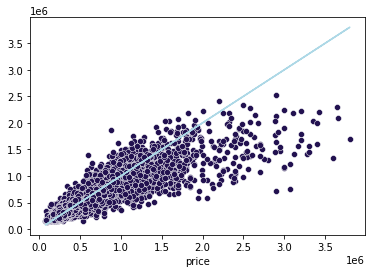

In [ ]:
ax = sns.scatterplot(x=np.exp(y_train), y=np.exp(y_train_pred))
ax.plot(np.exp(y_train), np.exp(y_train), 'lightblue');

### 2.3.3 Validation

In [ ]:
X_test = kc_test.drop('price', axis=1)
y_test = kc_test['price']

In [ ]:
X_test_scaled = pd.DataFrame(my_scaler.transform(X_test), columns=X_test.columns)

In [ ]:
y_test = np.log(y_test)

In [ ]:
y_test_pred = model_knn.predict(X_test_scaled)

In [ ]:
rmsle = np.sqrt(mse(y_test,
                                  y_test_pred))
print("RMSLE = {:.2f}".format(rmsle))

RMSLE = 0.22


In [ ]:
RMSE = mse(np.exp(y_test), np.exp(y_test_pred))**0.5
RMSE

164881.4500522376

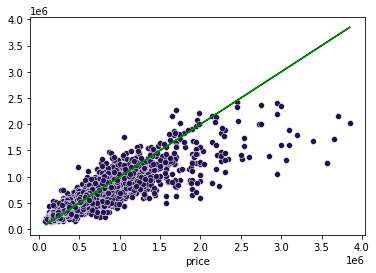

In [ ]:
ax = sns.scatterplot(x=np.exp(y_test), y=np.exp(y_test_pred))
ax.plot(np.exp(y_test), np.exp(y_test), 'g');

We got a great result, of only $1K between the train and test runs. Our results concluded in $164K gap from the end goal. 

### 2.3.3 Tweaking the model - Performance Improvement

Tweak 1 - Hyperparameters - n_neighbors increase from #6 to #50 and Minkowski Metric


In [ ]:
#Train set
# RMSE = mse(np.exp(y_train), np.exp(y_train_pred))**0.5
# RMSE

173689.6748714741

In [ ]:
#Test set
# RMSE = mse(np.exp(y_test), np.exp(y_test_pred))**0.5
# RMSE

168437.90009347314

Super vaild results, though rmse is extremly high

Tweak 2 : Weights 

In [ ]:
#Train set
# RMSE = mse(np.exp(y_train), np.exp(y_train_pred))**0.5
# RMSE

14091.41040061434

In [ ]:
#Test set
# RMSE = mse(np.exp(y_test), np.exp(y_test_pred))**0.5
# RMSE

166157.75232395652

Weighted distance does not assist us in validating the model nor our rmse

Tweak 3: Metric - change to Hamming Metric and expand our n_neighbors from 6 to 10. Will it work? 

In [ ]:
#Train set
# RMSE = mse(np.exp(y_train), np.exp(y_train_pred))**0.5
# RMSE

235967.00230922858

In [ ]:
#Test set
# RMSE = mse(np.exp(y_test), np.exp(y_test_pred))**0.5
# RMSE

251759.55872873028

Better validation, thuogh the error value we get still too high

Tweak 4: Manhatta Metrics

In [ ]:
#Train set
# RMSE = mse(np.exp(y_train), np.exp(y_train_pred))**0.5
# RMSE

159197.11815579183

In [ ]:
#Test set
# RMSE = mse(np.exp(y_test), np.exp(y_test_pred))**0.5
# RMSE

166627.80707266653

Best valid result so far between the test and trian run, though the value is too high for predection

Tweak 5: Cosine metric

In [ ]:
#Train set
# RMSE = mse(np.exp(y_train), np.exp(y_train_pred))**0.5
# RMSE

202043.584352521

In [ ]:
#Test set
# RMSE = mse(np.exp(y_test), np.exp(y_test_pred))**0.5
# RMSE

212388.35884193497

Great validation of the run, not as Manahattan, but still good. Our model is still problemtic error wise

In [ ]:
kc.columns

Index(['price', 'bedrooms', 'bathrooms', 'sqft_living', 'grade', 'sqft_above',
       'zip_value'],
      dtype='object')

Tweak 6 - User Defined Metric



In [ ]:
def my_distance(point1, point2):
    d_bedrooms = abs(point1[0] - point2[0])
    d_bathrooms = abs(point1[1] - point2[1])
    d_sqft_living = abs(point1[2] - point2[2])
    d_grade = abs(point1[3] - point2[3])
    d_sqft_above = abs(point1[4] - point2[4])
    d_zip_value = abs(point1[5] - point2[5])
    return 0.1*d_bedrooms + 2*d_bathrooms + 2*d_sqft_living + 3*d_grade + d_sqft_above + 2*d_zip_value

In [ ]:
#Train set
# RMSE = mse(np.exp(y_train), np.exp(y_train_pred))**0.5
# RMSE

155611.27373723852

In [ ]:
#Test set
# RMSE = mse(np.exp(y_test), np.exp(y_test_pred))**0.5
# RMSE

158939.83089149732

Best valided model so far with a 2% rmse and a lower value deviation of $158K

# The End




Appendix - Our plain vanila testing and further inspection of the models

Running the models without scaler nor cleaning

In [ ]:
kc

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,year_sold,yr_since_renovation,house_age
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,NaN,98178,47.5112,-122.257,1340,5650,2014,NaN,59
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991.0,98125,47.7210,-122.319,1690,7639,2014,23.0,63
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,NaN,98028,47.7379,-122.233,2720,8062,2015,NaN,82
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,NaN,98136,47.5208,-122.393,1360,5000,2014,NaN,49
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,NaN,98074,47.6168,-122.045,1800,7503,2015,NaN,28
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21608,263000018,20140521T000000,360000.0,3,2.50,1530,1131,3.0,0,0,3,8,1530,0,2009,NaN,98103,47.6993,-122.346,1530,1509,2014,NaN,5
21609,6600060120,20150223T000000,400000.0,4,2.50,2310,5813,2.0,0,0,3,8,2310,0,2014,NaN,98146,47.5107,-122.362,1830,7200,2015,NaN,1
21610,1523300141,20140623T000000,402101.0,2,0.75,1020,1350,2.0,0,0,3,7,1020,0,2009,NaN,98144,47.5944,-122.299,1020,2007,2014,NaN,5
21611,291310100,20150116T000000,400000.0,3,2.50,1600,2388,2.0,0,0,3,8,1600,0,2004,NaN,98027,47.5345,-122.069,1410,1287,2015,NaN,11


In [ ]:
tst_train, tst_test = split(kc, train_size=0.7, random_state=666)

In [ ]:
tst_lm = LinearRegression()

In [ ]:
X_train = tst_train.drop(['price','date','yr_renovated', 'yr_since_renovation'], axis=1)
y_train = tst_train['price']

In [ ]:
tst_lm.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [ ]:
tst_lm.intercept_

-46822270.81154564

In [ ]:
tst_lm.coef_

array([-9.44846392e-07, -3.74216346e+04,  4.14829469e+04,  1.07977057e+02,
        1.26873350e-01,  1.17449355e+04,  5.90595782e+05,  5.05180243e+04,
        2.56709747e+04,  9.93679376e+04,  6.58444290e+01,  4.21326277e+01,
        6.86394305e+03, -5.61221041e+02,  5.90709818e+05, -2.11831028e+05,
        2.86563754e+01, -4.16513912e-01,  1.64969562e+04,  9.63301311e+03])

In [ ]:
y_train_pred = tst_lm.predict(X_train)

In [ ]:
rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
rmse

200195.8664256337

$200k possible error with running a "clean" model.

In [ ]:
X_test = tst_test.drop(['price','date','yr_renovated', 'yr_since_renovation'], axis=1)
y_test = tst_test['price']

In [ ]:
y_test_pred = tst_lm.predict(X_test)

In [ ]:
rmse = np.sqrt(mean_squared_error(y_test, y_test_pred))
rmse

202384.79560900663

The model is valid, but not very accurate. Now let's see the results after data cleaning:

In [ ]:
kc

,price,bedrooms,bathrooms,sqft_living,grade,sqft_above,zip_value
0,221900.0,3,1.00,1180,7,1180,279000.0
1,538000.0,3,2.25,2570,7,2170,425000.0
2,180000.0,2,1.00,770,6,770,445500.0
3,604000.0,4,3.00,1960,7,1050,491975.0
4,510000.0,3,2.00,1680,8,1680,643250.0
...,...,...,...,...,...,...,...
21452,1007500.0,4,3.50,3510,9,2600,491975.0
21453,475000.0,3,2.50,1310,8,1180,562750.0
21454,360000.0,3,2.50,1530,8,1530,550000.0
21455,400000.0,4,2.50,2310,8,2310,309500.0


In [ ]:
tst_train, tst_test = split(kc, train_size=0.7, random_state=666)

In [ ]:
tst_lm = LinearRegression()

In [ ]:
X_train = tst_train.drop('price', axis=1)
y_train = tst_train['price']

In [ ]:
tst_lm.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [ ]:
tst_lm.intercept_

-553855.4723064187

In [ ]:
tst_lm.coef_

array([-3.17074541e+04, -1.34812783e+04,  2.19372625e+02,  6.15882843e+04,
       -4.50408490e+01,  7.81430364e-01])

In [ ]:
y_train_pred = tst_lm.predict(X_train)

In [ ]:
rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
rmse

185024.03825121396

The accuracy is still very lackluster...

In [ ]:
X_train = tst_train.drop(['price','zip_value'], axis=1)
y_train = tst_train['price']

In [ ]:
tst_lm.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [ ]:
tst_lm.intercept_

-563722.0300275635

In [ ]:
y_train_pred = tst_lm.predict(X_train)

In [ ]:
rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
rmse

232195.71018129605

Dropping the zip value had decreased our accuracy.
Let's bring it back, but with mean instead of median (median result - 185024)

In [ ]:
kc

,price,bedrooms,bathrooms,sqft_living,grade,sqft_above,zip_value
0,221900.0,3,1.00,1180,7,1180,311225.161538
1,538000.0,3,2.25,2570,7,2170,470190.848039
2,180000.0,2,1.00,770,6,770,463304.432624
3,604000.0,4,3.00,1960,7,1050,552920.118321
4,510000.0,3,2.00,1680,8,1680,686357.152273
...,...,...,...,...,...,...,...
21452,1007500.0,4,3.50,3510,9,2600,552920.118321
21453,475000.0,3,2.50,1310,8,1180,618634.169697
21454,360000.0,3,2.50,1530,8,1530,585210.608333
21455,400000.0,4,2.50,2310,8,2310,363044.939716


In [ ]:
tst_train, tst_test = split(kc, train_size=0.7, random_state=666)

In [ ]:
tst_lm = LinearRegression()

In [ ]:
X_train = tst_train.drop('price', axis=1)
y_train = tst_train['price']

In [ ]:
tst_lm.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [ ]:
tst_lm.intercept_

-541727.702708259

In [ ]:
y_train_pred = tst_lm.predict(X_train)

In [ ]:
rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
rmse

182037.81138234303

Very slight improvement. Let's try min value:

In [ ]:
tst_train, tst_test = split(kc, train_size=0.7, random_state=666)

In [ ]:
tst_lm = LinearRegression()

In [ ]:
X_train = tst_train.drop('price', axis=1)
y_train = tst_train['price']

In [ ]:
tst_lm.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [ ]:
tst_lm.intercept_

-505004.45458106394

In [ ]:
y_train_pred = tst_lm.predict(X_train)

In [ ]:
rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
rmse

204881.9815441003

The mean value was the most accurate so far.

In [ ]:
kc['zip_value'] = kc['zip_value']/1000

In [ ]:
kc

,price,bedrooms,bathrooms,sqft_living,grade,sqft_above,zip_value
0,221900.0,3,1.00,1180,7,1180,311.225162
1,538000.0,3,2.25,2570,7,2170,470.190848
2,180000.0,2,1.00,770,6,770,463.304433
3,604000.0,4,3.00,1960,7,1050,552.920118
4,510000.0,3,2.00,1680,8,1680,686.357152
...,...,...,...,...,...,...,...
21452,1007500.0,4,3.50,3510,9,2600,552.920118
21453,475000.0,3,2.50,1310,8,1180,618.634170
21454,360000.0,3,2.50,1530,8,1530,585.210608
21455,400000.0,4,2.50,2310,8,2310,363.044940


In [ ]:
tst_train, tst_test = split(kc, train_size=0.7, random_state=666)

In [ ]:
tst_lm = LinearRegression()

In [ ]:
X_train = tst_train.drop('price', axis=1)
y_train = tst_train['price']

In [ ]:
tst_lm.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [ ]:
tst_lm.intercept_

-541727.7027075232

In [ ]:
y_train_pred = tst_lm.predict(X_train)

In [ ]:
rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
rmse

182037.81138234303

In [ ]:
tst_lm.coef_

array([-3.22208626e+04, -1.18232607e+04,  2.12986151e+02,  6.01499658e+04,
       -3.62199238e+01,  6.97573239e+02])

In [ ]:
kc['zip_value'] = kc['zip_value']/100

In [ ]:
kc

,price,bedrooms,bathrooms,sqft_living,grade,sqft_above,zip_value
0,221900.0,3,1.00,1180,7,1180,3.112252
1,538000.0,3,2.25,2570,7,2170,4.701908
2,180000.0,2,1.00,770,6,770,4.633044
3,604000.0,4,3.00,1960,7,1050,5.529201
4,510000.0,3,2.00,1680,8,1680,6.863572
...,...,...,...,...,...,...,...
21452,1007500.0,4,3.50,3510,9,2600,5.529201
21453,475000.0,3,2.50,1310,8,1180,6.186342
21454,360000.0,3,2.50,1530,8,1530,5.852106
21455,400000.0,4,2.50,2310,8,2310,3.630449


In [ ]:
tst_train, tst_test = split(kc, train_size=0.7, random_state=666)

In [ ]:
tst_lm = LinearRegression()

In [ ]:
X_train = tst_train.drop('price', axis=1)
y_train = tst_train['price']

In [ ]:
tst_lm.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [ ]:
tst_lm.intercept_

-541727.7027075083

In [ ]:
y_train_pred = tst_lm.predict(X_train)

In [ ]:
rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
rmse

182037.81138234303

In [ ]:
kc['sqft_above'] = kc['sqft_above']*3

In [ ]:
kc

,price,bedrooms,bathrooms,sqft_living,grade,sqft_above,zip_value
0,221900.0,3,1.00,1180,7,3540,3.112252
1,538000.0,3,2.25,2570,7,6510,4.701908
2,180000.0,2,1.00,770,6,2310,4.633044
3,604000.0,4,3.00,1960,7,3150,5.529201
4,510000.0,3,2.00,1680,8,5040,6.863572
...,...,...,...,...,...,...,...
21452,1007500.0,4,3.50,3510,9,7800,5.529201
21453,475000.0,3,2.50,1310,8,3540,6.186342
21454,360000.0,3,2.50,1530,8,4590,5.852106
21455,400000.0,4,2.50,2310,8,6930,3.630449


In [ ]:
tst_train, tst_test = split(kc, train_size=0.7, random_state=666)

In [ ]:
tst_lm = LinearRegression()

In [ ]:
X_train = tst_train.drop('price', axis=1)
y_train = tst_train['price']

In [ ]:
tst_lm.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [ ]:
tst_lm.intercept_

-541727.7027075109

In [ ]:
y_train_pred = tst_lm.predict(X_train)

In [ ]:
rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
rmse

182037.81138234303

In [ ]:
X_train = tst_train.drop(['price','sqft_above'], axis=1)
y_train = tst_train['price']

In [ ]:
tst_lm.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [ ]:
tst_lm.intercept_

-518993.6624314762

In [ ]:
y_train_pred = tst_lm.predict(X_train)

In [ ]:
rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
rmse

182540.6537713717

In [ ]:
kc['zip_value'] = kc['zip_value']*100000

In [ ]:
kc['zip_value'] = np.log(kc['zip_value'])

In [ ]:
kc

,price,bedrooms,bathrooms,sqft_living,grade,sqft_above,zip_value
0,221900.0,3,1.00,1180,7,3540,12.648272
1,538000.0,3,2.25,2570,7,6510,13.060894
2,180000.0,2,1.00,770,6,2310,13.046140
3,604000.0,4,3.00,1960,7,3150,13.222969
4,510000.0,3,2.00,1680,8,5040,13.439153
...,...,...,...,...,...,...,...
21452,1007500.0,4,3.50,3510,9,7800,13.222969
21453,475000.0,3,2.50,1310,8,3540,13.335269
21454,360000.0,3,2.50,1530,8,4590,13.279727
21455,400000.0,4,2.50,2310,8,6930,12.802282


In [ ]:
tst_train, tst_test = split(kc, train_size=0.7, random_state=666)

In [ ]:
tst_lm = LinearRegression()

In [ ]:
X_train = tst_train.drop('price', axis=1)
y_train = tst_train['price']

In [ ]:
tst_lm.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [ ]:
tst_lm.intercept_

-5201355.506121204

In [ ]:
y_train_pred = tst_lm.predict(X_train)

In [ ]:
rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
rmse

187513.12910551846

In [ ]:
tst_lm.coef_

array([-3.02804582e+04, -1.58799859e+04,  2.18642884e+02,  6.12863841e+04,
       -1.23340759e+01,  3.82536491e+05])

In [ ]:
X_train = tst_train.drop(['price','grade'], axis=1)
y_train = tst_train['price']

In [ ]:
tst_lm.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [ ]:
tst_lm.intercept_

-5244686.9060138455

In [ ]:
y_train_pred = tst_lm.predict(X_train)

In [ ]:
rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
rmse

191872.99997344808

**Let's try DT with clean data (no target log and without scaling):**

In [ ]:
X = kc.drop('price', axis=1)
y = kc.price

In [ ]:
X_train, X_test, y_train, y_test = split(X, y, random_state=9123,test_size=0.3)

In [ ]:
dt_model = DecisionTreeRegressor(max_depth=20).fit(X_train, y_train)
dt_model

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=20,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

In [ ]:
def visualize_tree(model, md=2):
    dot_data = StringIO()  
    export_graphviz(model, out_file=dot_data, feature_names=X_train.columns, max_depth=md)
    graph = pydot.graph_from_dot_data(dot_data.getvalue())[0]  
    return Image(graph.create_png(), width=800) 

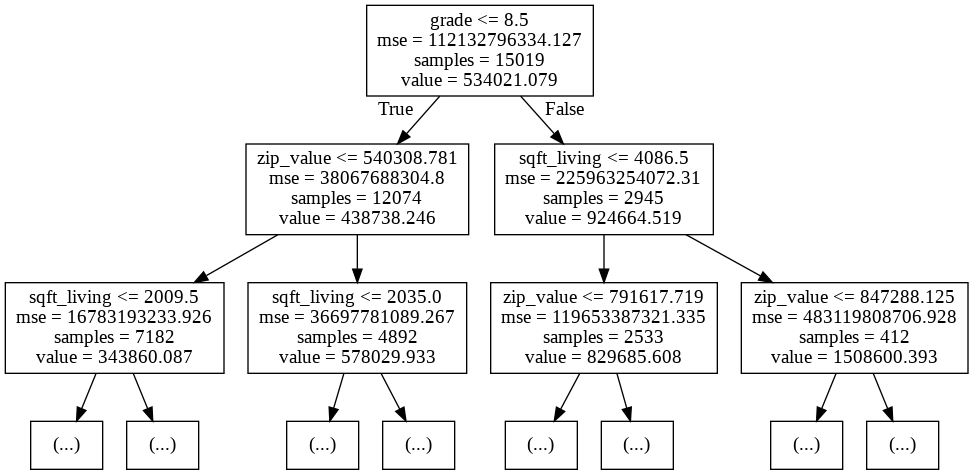

In [ ]:
visualize_tree(dt_model, md=2)

In [ ]:
for feature, importance in zip(X.columns, dt_model.feature_importances_):
    print(f'{feature:12}: {importance}')

bedrooms    : 0.022459704540059536
bathrooms   : 0.0315347881700659
sqft_living : 0.2382125875892687
grade       : 0.3555463903202499
sqft_above  : 0.06217284713702913
zip_value   : 0.29007368224332686


In [ ]:
y_train_pred = dt_model.predict(X_train)

In [ ]:
rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
rmse

26453.592605191898

**Much better result, compared to Linear Regression, but are they valid?**

In [ ]:
y_test_pred = dt_model.predict(X_test)

In [ ]:
rmse = np.sqrt(mean_squared_error(y_test, y_test_pred))
rmse

224131.66228265763

**Not valid at all!**

In [ ]:
X = kc.drop('price', axis=1)
y = kc.price

In [ ]:
X_train, X_test, y_train, y_test = split(X, y, random_state=9123,test_size=0.3)

In [ ]:
dt_model = DecisionTreeRegressor(max_depth=20, criterion='mae').fit(X_train, y_train)
dt_model

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=20,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

In [ ]:
def visualize_tree(model, md=2):
    dot_data = StringIO()  
    export_graphviz(model, out_file=dot_data, feature_names=X_train.columns, max_depth=md)
    graph = pydot.graph_from_dot_data(dot_data.getvalue())[0]  
    return Image(graph.create_png(), width=800) 

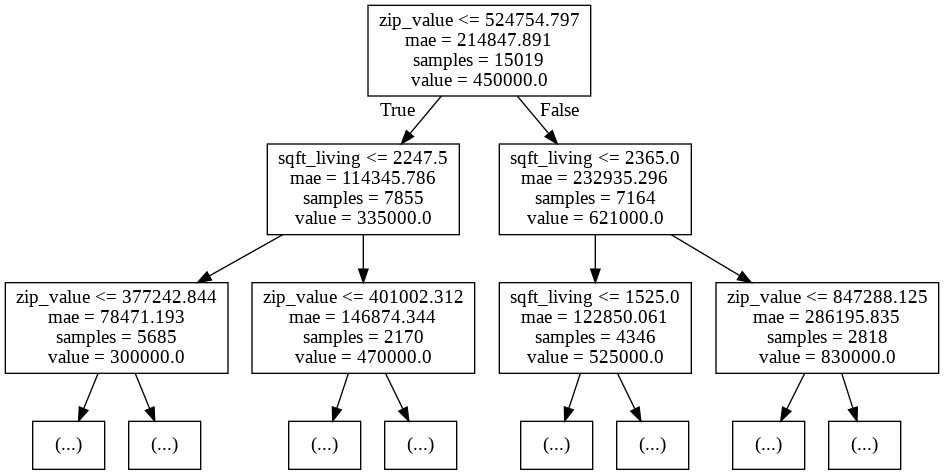

In [ ]:
visualize_tree(dt_model, md=2)

In [ ]:
for feature, importance in zip(X.columns, dt_model.feature_importances_):
    print(f'{feature:12}: {importance}')

bedrooms    : 0.036867437996226354
bathrooms   : 0.05292138821446647
sqft_living : 0.35060704774750534
grade       : 0.056980640294343944
sqft_above  : 0.10891618208458433
zip_value   : 0.3937073036628735


In [ ]:
y_train_pred = dt_model.predict(X_train)

In [ ]:
rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
rmse

40181.58867182569

In [ ]:
y_test_pred = dt_model.predict(X_test)

In [ ]:
rmse = np.sqrt(mean_squared_error(y_test, y_test_pred))
rmse

223265.68041736993

The "mae" criterion reduced our accuracy. The model is still not valid.
Let's put our target in log:

In [ ]:
X = kc.drop('price', axis=1)
y = kc.price

In [ ]:
X_train, X_test, y_train, y_test = split(X, y, random_state=9123,test_size=0.3)

In [ ]:
y_train = np.log(y_train)

In [ ]:
dt_model = DecisionTreeRegressor(max_depth=20).fit(X_train, y_train)
dt_model

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=20,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

In [ ]:
def visualize_tree(model, md=2):
    dot_data = StringIO()  
    export_graphviz(model, out_file=dot_data, feature_names=X_train.columns, max_depth=md)
    graph = pydot.graph_from_dot_data(dot_data.getvalue())[0]  
    return Image(graph.create_png(), width=800) 

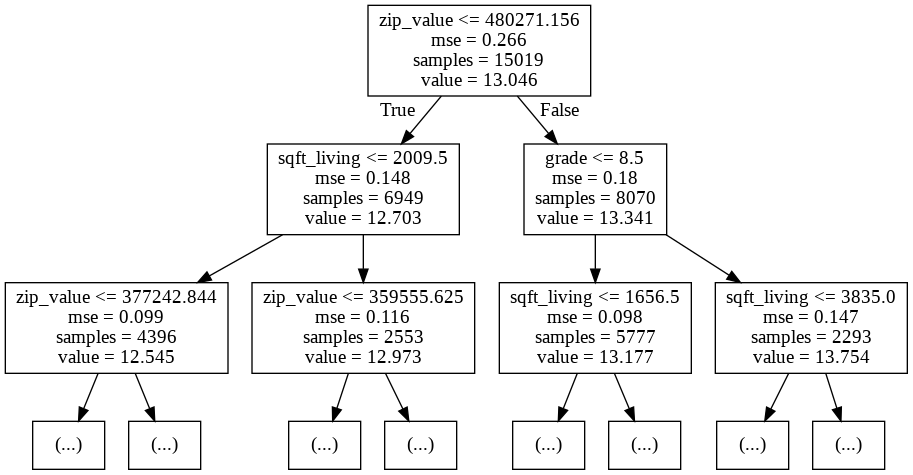

In [ ]:
visualize_tree(dt_model, md=2)

In [ ]:
y_train_pred = dt_model.predict(X_train)

In [ ]:
rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
rmse

0.054922927356338906

In [ ]:
rmse = np.sqrt(mean_squared_error(np.exp(y_train), np.exp(y_train_pred)))
rmse

26955.103818195428

We can see that loging our target had slightly decreased our accuracy.

In [ ]:
X = kc.drop('price', axis=1)
y = kc.price

In [ ]:
X_train, X_test, y_train, y_test = split(X, y, random_state=555,test_size=0.5)

In [ ]:
dt_model = DecisionTreeRegressor(max_depth=40, ).fit(X_train, y_train)
dt_model

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=40,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

In [ ]:
def visualize_tree(model, md=2):
    dot_data = StringIO()  
    export_graphviz(model, out_file=dot_data, feature_names=X_train.columns, max_depth=md)
    graph = pydot.graph_from_dot_data(dot_data.getvalue())[0]  
    return Image(graph.create_png(), width=800) 

In [ ]:
y_train_pred = dt_model.predict(X_train)

In [ ]:
rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
rmse

12005.317762298127

Incresing the max depth to 40 had significantly increased the accuracy of our prediction.

In [ ]:
y_test_pred = dt_model.predict(X_test)

In [ ]:
rmse = np.sqrt(mean_squared_error(y_test, y_test_pred))
rmse

223475.17557964323

**The accuracy is not valid and unreliable. Let's try with logs:**

In [ ]:
X = kc.drop('price', axis=1)
y = kc.price

In [ ]:
X_train, X_test, y_train, y_test = split(X, y, random_state=9123,test_size=0.3)

In [ ]:
y_train = np.log(y_train)

In [ ]:
dt_model = DecisionTreeRegressor(max_depth=40).fit(X_train, y_train)
dt_model

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=40,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

In [ ]:
def visualize_tree(model, md=2):
    dot_data = StringIO()  
    export_graphviz(model, out_file=dot_data, feature_names=X_train.columns, max_depth=md)
    graph = pydot.graph_from_dot_data(dot_data.getvalue())[0]  
    return Image(graph.create_png(), width=800) 

In [ ]:
y_train_pred = dt_model.predict(X_train)

In [ ]:
# logs
rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
rmse

0.03805805190978204

In [ ]:
# real numbers
rmse = np.sqrt(mean_squared_error(np.exp(y_train), np.exp(y_train_pred)))
rmse

14841.282672574309

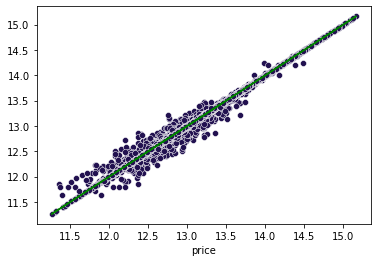

In [ ]:
ax = sns.scatterplot(x=y_train, y=y_train_pred)
ax.plot(y_train, y_train, 'g');

Validation:

In [ ]:
y_test_pred = dt_model.predict(X_test)

In [ ]:
y_test = np.log(y_test)

In [ ]:
# logs
rmse = np.sqrt(mean_squared_error(y_test, y_test_pred))
rmse

0.28746033861106657

In [ ]:
# real numbers
rmse = np.sqrt(mean_squared_error(np.exp(y_test), np.exp(y_test_pred)))
rmse

225547.16360979728

Still same result..

Onto KNN:

In [ ]:
kc_train, kc_test = split(kc, test_size=0.3, 
                              random_state=11320)

X_train = kc_train.drop('price', axis=1)
y_train = kc_train['price']

In [ ]:
model_knn = KNeighborsRegressor(n_neighbors=6 , metric='manhattan', weights='distance' ).fit(X_train, y_train)

In [ ]:
y_train_pred = model_knn.predict(X_train)

In [ ]:
rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
rmse

13963.06889794831

Validation:

In [ ]:
X_test = kc_test.drop('price', axis=1)
y_test = kc_test['price']

In [ ]:
y_test_pred = model_knn.predict(X_test)

In [ ]:
rmse = np.sqrt(mean_squared_error(y_test, y_test_pred))
rmse

172453.76818905203

Is the dataset valid / reliable?

# Daniel - Select K-Best, Cross Validation and Grid Search for DT regressor

**Select KBest - DT model:**

In [ ]:
# X_train = tst_train.drop(['price','date','yr_renovated', 'yr_since_renovation'], axis=1)
# y_train = tst_train['price']

In [ ]:
kc

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,lat,long,sqft_living15,sqft_lot15,year_sold,house_age,zip_value
0,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,47.5112,-122.257,1340,5650,2014,59,310612.755725
1,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,47.7210,-122.319,1690,7639,2014,63,469455.770732
2,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,47.7379,-122.233,2720,8062,2015,82,462480.035336
3,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,47.5208,-122.393,1360,5000,2014,49,551688.673004
4,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,47.6168,-122.045,1800,7503,2015,28,685605.775510
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21606,1007500.0,4,3.50,3510,7200,2.0,0,0,3,9,2600,910,2009,47.5537,-122.398,2050,6200,2015,6,551688.673004
21607,475000.0,3,2.50,1310,1294,2.0,0,0,3,8,1180,130,2008,47.5773,-122.409,1330,1265,2015,7,618634.169697
21608,360000.0,3,2.50,1530,1131,3.0,0,0,3,8,1530,0,2009,47.6993,-122.346,1530,1509,2014,5,584919.210963
21609,400000.0,4,2.50,2310,5813,2.0,0,0,3,8,2310,0,2014,47.5107,-122.362,1830,7200,2015,1,359483.239583


In [ ]:
kc = kc.drop(['date','yr_renovated','yr_since_renovation','id'], axis=1)

In [ ]:
# backup = kc.copy()
# kc = backup.copy()

In [ ]:
X = kc.drop('price', axis=1)
y = kc['price']

In [ ]:
X_train, X_test, y_train, y_test = split(X, y, 
                                                    train_size=0.75, 
                                                    test_size=0.25,
                                                    shuffle=True)

In [ ]:
MAS = MaxAbsScaler().fit(X_train) #Max ABS Scaler
X_train_scaled = pd.DataFrame(MAS.transform(X_train), columns=X_train.columns)
X_train_scaled.head()

,bedrooms,bathrooms,sqft_living,grade,sqft_above,zip_value
0,0.333333,0.409091,0.238571,0.615385,0.278798,0.302406
1,0.333333,0.181818,0.124286,0.461538,0.145242,0.163166
2,0.222222,0.500000,0.157143,0.538462,0.125209,0.427482
3,0.444444,0.272727,0.348571,0.615385,0.240401,0.345532
4,0.333333,0.454545,0.275714,0.615385,0.322204,0.146969


In [ ]:
SKB = SelectKBest(f_classif, k=7) # Select K best

In [ ]:
y_train = np.log(y_train) #scaling the target

In [ ]:
X_train_reduced = \
    pd.DataFrame(SKB.fit_transform(X_train_scaled, y_train), 
                 columns=X_train_scaled.columns[SKB.get_support()].values)
X_train_reduced.head()

,bathrooms,sqft_living,grade,sqft_above,lat,sqft_living15,zip_value
0,0.454545,0.302857,0.538462,0.362765,0.991668,0.409326,0.169798
1,0.409091,0.251429,0.692308,0.301164,0.996436,0.232470,0.293603
2,0.363636,0.192857,0.538462,0.231006,0.995029,0.240069,0.285564
3,0.181818,0.135714,0.461538,0.162560,0.993999,0.314335,0.111232
4,0.500000,0.320000,0.538462,0.195072,0.990751,0.272884,0.129966


In [ ]:
def visualize_tree(model, md=5, width=800):
    dot_data = StringIO()  
    export_graphviz(model, out_file=dot_data, feature_names=X_train_reduced.columns, max_depth=md, label='none')
    graph = pydot.graph_from_dot_data(dot_data.getvalue())[0]  
    return Image(graph.create_png(), width=width) 

In [ ]:
def print_dot_text(model, md=5):
    """The output of this function can be copied to http://www.webgraphviz.com/"""
    dot_data = StringIO()
    export_graphviz(model, out_file=dot_data, feature_names=X_train_reduced.columns, max_depth=md)
    dot_text = dot_data.getvalue()
    print(dot_text)

In [ ]:
dt_model_1 = DecisionTreeRegressor().fit(X_train_reduced, y_train)

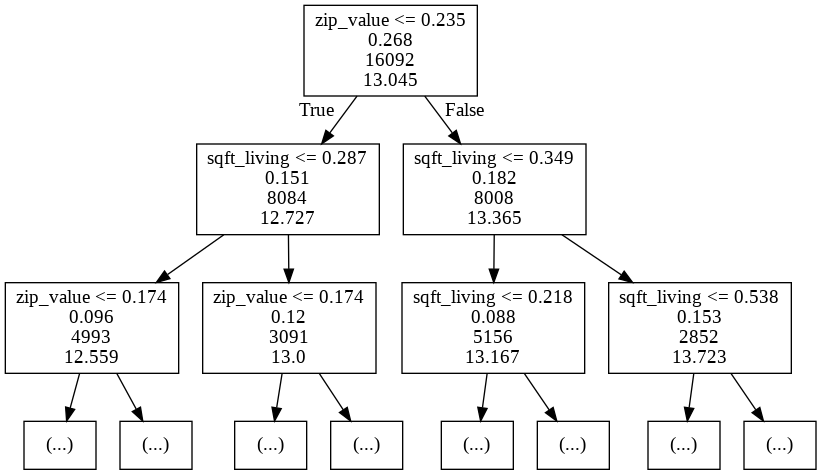

In [ ]:
visualize_tree(dt_model_1, md=2, width=1200)

**Cross Validation:**

In [ ]:
dt_scores = cross_val_score(dt_model_1, X_train_reduced, y_train, cv = 5)

In [ ]:
print("mean cross validation score: {}".format(np.mean(dt_scores)))
print("score without cv: {}".format(dt_model_1.score(X_train_reduced, y_train)))

mean cross validation score: 0.721205837014813
score without cv: 0.9976450804082594


In [ ]:
cross_val_score(dt_model_1, X_train_reduced, y_train, cv=5)

array([0.73651356, 0.72501668, 0.7290075 , 0.72559447, 0.69730158])

**Grid Search**

In [ ]:
param_grid = {"criterion": ["mse", "mae"],
              "min_samples_split": [10, 20, 40],
              "max_depth": [2, 6, 8],
              "min_samples_leaf": [20, 40, 100],
              "max_leaf_nodes": [5, 20, 100],
              }

In [ ]:
grid_cv_dtm = GridSearchCV(dt_model_1, param_grid, cv=5)

In [ ]:
# Careful, this runs for 15 minutes!
grid_cv_dtm.fit(X_train_reduced,y_train)

GridSearchCV(cv=5, error_score=nan,
             estimator=DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse',
                                             max_depth=None, max_features=None,
                                             max_leaf_nodes=None,
                                             min_impurity_decrease=0.0,
                                             min_impurity_split=None,
                                             min_samples_leaf=1,
                                             min_samples_split=2,
                                             min_weight_fraction_leaf=0.0,
                                             presort='deprecated',
                                             random_state=None,
                                             splitter='best'),
             iid='deprecated', n_jobs=None,
             param_grid={'criterion': ['mse', 'mae'], 'max_depth': [2, 6, 8],
                         'max_leaf_nodes': [5, 20, 100],
                    

In [ ]:
print("Best Hyperparameters::\n{}".format(grid_cv_dtm.best_params_))

Best Hyperparameters::
{'criterion': 'mse', 'max_depth': 8, 'max_leaf_nodes': 100, 'min_samples_leaf': 40, 'min_samples_split': 20}


In [ ]:
df = pd.DataFrame(data=grid_cv_dtm.cv_results_)
df.head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_criterion,param_max_depth,param_max_leaf_nodes,param_min_samples_leaf,param_min_samples_split,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
0,0.014219,0.002140,0.001680,0.000081,mse,2,5,20,10,"{'criterion': 'mse', 'max_depth': 2, 'max_leaf...",0.591454,0.595917,0.612595,0.573026,0.549819,0.584562,0.021459,126
1,0.013994,0.001522,0.001655,0.000029,mse,2,5,20,20,"{'criterion': 'mse', 'max_depth': 2, 'max_leaf...",0.591454,0.595917,0.612595,0.573026,0.549819,0.584562,0.021459,119
2,0.012988,0.000236,0.001718,0.000097,mse,2,5,20,40,"{'criterion': 'mse', 'max_depth': 2, 'max_leaf...",0.591454,0.595917,0.612595,0.573026,0.549819,0.584562,0.021459,126
3,0.013061,0.000312,0.001870,0.000399,mse,2,5,40,10,"{'criterion': 'mse', 'max_depth': 2, 'max_leaf...",0.591454,0.595917,0.612595,0.573026,0.549819,0.584562,0.021459,119
4,0.013135,0.000302,0.001659,0.000020,mse,2,5,40,20,"{'criterion': 'mse', 'max_depth': 2, 'max_leaf...",0.591454,0.595917,0.612595,0.573026,0.549819,0.584562,0.021459,109


# Tal - Feature Selection- SelectKBest, Cross Validation snd Grid Selection

In [ ]:
X = kc.drop('price', axis=1)
y = kc.price

X_train, X_test, y_train, y_test = split(X, y,train_size=0.75, 
                                                    test_size=0.25,
                                                    shuffle=True)

In [ ]:
kc_selector = SelectKBest(score_func=f_classif, k=5)

In [ ]:
y_train = np.log(y_train) 

In [ ]:
my_Scaler = MaxAbsScaler().fit(X_train)
X_train_scaled = pd.DataFrame(my_Scaler.transform(X_train), columns=X_train.columns)
X_train_scaled.head()

,bedrooms,bathrooms,sqft_living,grade,sqft_above,yr_built,zip_value
0,0.333333,0.454545,0.217143,0.538462,0.193656,0.989082,0.175352
1,0.444444,0.454545,0.480286,0.615385,0.561269,0.994541,0.153844
2,0.444444,0.409091,0.472857,0.692308,0.277129,0.979156,0.441215
3,0.444444,0.500000,0.384286,0.615385,0.292154,0.981638,0.318490
4,0.444444,0.454545,0.264286,0.538462,0.308848,0.989082,0.157388


In [ ]:
X_train_cols_reduce = \
    pd.DataFrame(kc_selector.fit_transform(X_train_scaled, y_train), 
                 columns=X_train_scaled.columns[kc_selector.get_support()].values)
X_train_cols_reduce.head()

,bathrooms,sqft_living,grade,sqft_above,zip_value
0,0.454545,0.217143,0.538462,0.193656,0.175352
1,0.454545,0.480286,0.615385,0.561269,0.153844
2,0.409091,0.472857,0.692308,0.277129,0.441215
3,0.500000,0.384286,0.615385,0.292154,0.318490
4,0.454545,0.264286,0.538462,0.308848,0.157388


In [ ]:
dt_model_1 = DecisionTreeRegressor().fit(X_train_cols_reduce, y_train)

In [ ]:
def print_dot_text(model, md=5):
    """The output of this function can be copied to http://www.webgraphviz.com/"""
    dot_data = StringIO()
    export_graphviz(model, out_file=dot_data, feature_names=X_train.columns, max_depth=md)
    dot_text = dot_data.getvalue()
    print(dot_text)

In [ ]:
def visualize_tree(model, md=5, width=800):
    dot_data = StringIO()  
    export_graphviz(model, out_file=dot_data, feature_names=X_train_cols_reduce.columns, max_depth=md, label='none')
    graph = pydot.graph_from_dot_data(dot_data.getvalue())[0]  
    return Image(graph.create_png(), width=width) 

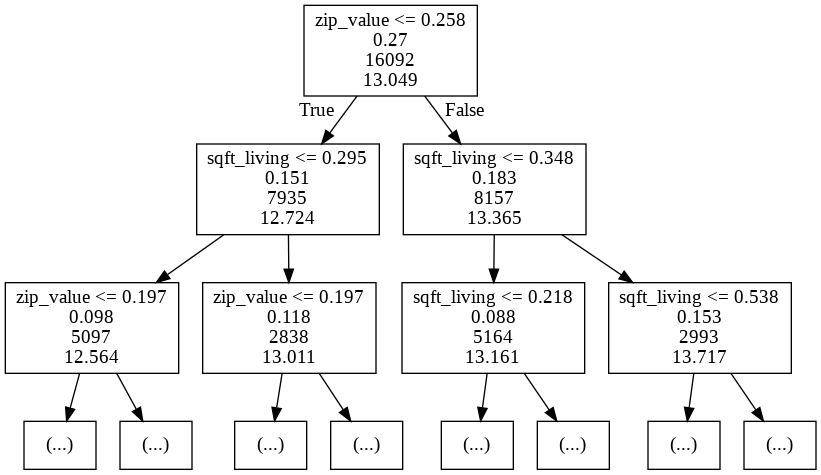

In [ ]:
visualize_tree(dt_model_1, md=2, width=1200)

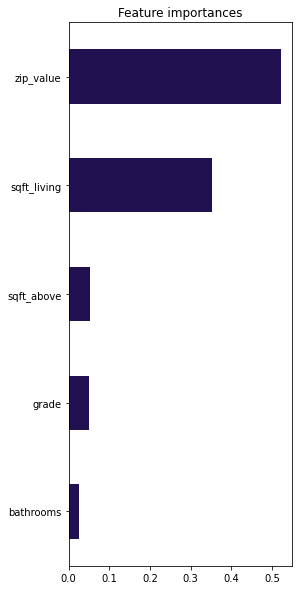

In [ ]:
pd.Series(dt_model_1.feature_importances_, index=X_train_cols_reduce.columns).sort_values()\
    .plot.barh(figsize=(4, 10), rot=0, title='Feature importances');

# Cross Validation

In [ ]:
from sklearn.model_selection import train_test_split, cross_val_score
import matplotlib.pyplot as plt

In [ ]:
kc_scores = cross_val_score(dt_model_1, X_train, y_train, cv=k)

print("Scores : " + (k * "{:.3f} ").format(*kc_scores))
# print("Score without vc : " + (  {:.3f} ").format(dt_model_1.score(X_train_cols_reduce,y_train)))

In [ ]:
dt_scores = cross_val_score(dt_model_1, X_train_cols_reduce, y_train, cv = 5)

In [ ]:
print("cross validation score: {}".format(dt_scores))

cross validation score: [0.70367737 0.71277952 0.71248624 0.70886367 0.69875096]


# Regularization & grid search

In [ ]:
kc_params_grid = {'min_samples_leaf': [20, 40, 60],
                 'min_weight_fraction_leaf': [0.01, 0.02, 0.05],
                 'criterion': ['mse', 'mae'], 
                 'min_impurity_decrease': [1e-5, 1e-6, 1e-7]}

In [ ]:
kc_gs = GridSearchCV(dt_model_1, kc_params_grid, cv=5)
kc_gs.fit(X_train_cols_reduce, y_train)

In [ ]:
print("Best parameters:{}".format(kc_gs.best_params_))